# Goggle Advanced Data Analytics 
## Course 6 Machine Learning 
### MOdule 1Feature Engineering with Python 
**Customer Churn**
Business term that describes how many and at what rate customer stop using a product or service, or stop doing business with a company altogether
**- Feature Selection**
    - Removing uniformative features

**- Feature Extraction**
    - Creating new features from existing features

**- Feature Transformation**
    - Modifying existing features to better suit our objectives 
    - Encoding of categorical features as dummies

In [1]:
import numpy as np 
import pandas as pd

In [2]:
# Read in data
df_original = pd.read_csv('Churn_Modelling.csv')


In [3]:
df_original.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [4]:
# Print high-level info about data 
df_original.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


#### Feature Engineering 
##### Feature selection 
Feature selection is the process of choosing features to be used for modeling. I 

In [6]:
# Create a new df that drops RowNumber, CustomerId, Surname, and Gender cols
churn_df = df_original.drop(['RowNumber', 'CustomerId', 'Surname', 'Gender'], axis=1)

In [7]:
churn_df.head()

,CreditScore,Geography,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,619,France,42,2,0.00,1,1,1,101348.88,1
1,608,Spain,41,1,83807.86,1,0,1,112542.58,0
2,502,France,42,8,159660.80,3,1,0,113931.57,1
3,699,France,39,1,0.00,2,0,0,93826.63,0
4,850,Spain,43,2,125510.82,1,1,1,79084.10,0


##### Feature extraction 
> The process of taking two or more features and using to create a brand new feature
lET'S CREATE A `Loyalty` feature that represents the percentage of each customer's life that they were customers. We can do this by divding `Tenure` by `Age`:
`Loyalty = Tenure/Age`

In [8]:
# Create Loyalty variable 
churn_df['Loyalty'] = churn_df['Tenure']/churn_df['Age']

In [9]:
churn_df.head()

,CreditScore,Geography,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Loyalty
0,619,France,42,2,0.00,1,1,1,101348.88,1,0.047619
1,608,Spain,41,1,83807.86,1,0,1,112542.58,0,0.024390
2,502,France,42,8,159660.80,3,1,0,113931.57,1,0.190476
3,699,France,39,1,0.00,2,0,0,93826.63,0,0.025641
4,850,Spain,43,2,125510.82,1,1,1,79084.10,0,0.046512


##### Feature Transformation
> Feature transformation is the process of changing how a single feature is represented in the dataset with the goal of improving the accuracy of the model.
The models we will be building with this data are all classification models, and classification models generally need categorical variables to be encoded. Our dataset has one categorical feature: `Geography`. 

In [10]:
# Print unique values of Geography column
churn_df['Geography'].unique()

array(['France', 'Spain', 'Germany'], dtype=object)

> - Encode this data so it can be represented using Boolean features. 
> - We wil use a pandas function called `pd.get_dummies()` to do this.

In [13]:
# Dummy encode categorical variables 
churn_df = pd.get_dummies(churn_df, drop_first=True)
churn_df.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Loyalty,Geography_Germany,Geography_Spain
0,619,42,2,0.00,1,1,1,101348.88,1,0.047619,False,False
1,608,41,1,83807.86,1,0,1,112542.58,0,0.024390,False,True
2,502,42,8,159660.80,3,1,0,113931.57,1,0.190476,False,False
3,699,39,1,0.00,2,0,0,93826.63,0,0.025641,False,False
4,850,43,2,125510.82,1,1,1,79084.10,0,0.046512,False,True


In [15]:
churn_df.to_csv('churn_df.csv', index=False)

### MOdule 2 Naive Bayes Model
> The modeling objective is to build and test a Naive Bayes model that uses banking data to predict whether a customer will churn. If a customer churns, it means they left the bank and took their business elsewhere. if we can predict customers who are likely to churn, we can take measures to retain them before they do. these measures could be promotions, discounts, or other incentives to boost customer satisfaction and therefore retention.

#### Naive Bayes implementations in scikit-learn 
1. GaussianNB (used for continuous, normally distributed features)
2. MultinomialNB (used for discrete features)
3. BernoulliNB (used for Boolean features)
4. CategoricalNB (used for categorical features)

- We are going to use the `GaussianNB` classifier. 

In [24]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 

from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB

from sklearn.metrics import recall_score, precision_score, f1_score, accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

Read in the previous excercise data 

In [25]:
churn_df = pd.read_csv('churn_df.csv')
churn_df.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Loyalty,Geography_Germany,Geography_Spain
0,619,42,2,0.00,1,1,1,101348.88,1,0.047619,False,False
1,608,41,1,83807.86,1,0,1,112542.58,0,0.024390,False,True
2,502,42,8,159660.80,3,1,0,113931.57,1,0.190476,False,False
3,699,39,1,0.00,2,0,0,93826.63,0,0.025641,False,False
4,850,43,2,125510.82,1,1,1,79084.10,0,0.046512,False,True


In [26]:
# Check class balance
churn_df['Exited'].value_counts()

Exited
0    7963
1    2037
Name: count, dtype: int64

In [27]:
# Drop tenure and AGe variables
churn_df = churn_df.drop(['Tenure', 'Age'], axis=1)
churn_df.head()

,CreditScore,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Loyalty,Geography_Germany,Geography_Spain
0,619,0.00,1,1,1,101348.88,1,0.047619,False,False
1,608,83807.86,1,0,1,112542.58,0,0.024390,False,True
2,502,159660.80,3,1,0,113931.57,1,0.190476,False,False
3,699,0.00,2,0,0,93826.63,0,0.025641,False,False
4,850,125510.82,1,1,1,79084.10,0,0.046512,False,True


In [28]:
# Define the y (target) variable
y = churn_df['Exited']

# Define the X (predictor) variables
X = churn_df.copy()
X = X.drop('Exited', axis=1)

# Split into train and test sets 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

#### Modeling
1. Unscaled data:


In [30]:
# Fit the model 
gnb = GaussianNB()
gnb.fit(X_train, y_train)

# Get the predictions on test data
y_preds = gnb.predict(X_test)

In [31]:
print('Accuracy:', '%.3f' % accuracy_score(y_test, y_preds))
print('Precision:', '%.3f' % precision_score(y_test, y_preds))
print('Recall:', '%.3f' % recall_score(y_test, y_preds))
print('F1 score:', '%.3f' % f1_score(y_test, y_preds))

Accuracy: 0.796
Precision: 0.000
Recall: 0.000
F1 score: 0.000


/home/adnan/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [33]:
# check unique vakues in predictions
np.unique(y_preds)

array([0])

In [34]:
# Get descriptive stats for data 
X.describe()

,CreditScore,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Loyalty
count,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,650.528800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.137936
std,96.653299,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.089506
min,350.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,584.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.064516
50%,652.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.129032
75%,718.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.200000
max,850.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,0.555556


#### Scaled data
We will use a function called `MinMaxScaler`, which we'll import from the `sklearn.preprocessing` module. `MinMaxScaler` normalizes each column so every value falls in the range of [0, 1].
- The column's maximum value would scale to 1, and its minimum value would scale to 0. Everything else would fall somewhere between. This is the formula:

`Xscaled = X - Xmin / Xmax - Xmin`

To use a scaler, you must fit it to the training data, and transform both the training data and the test data using that same scaler. 


In [36]:
# IMport the scaler function 
from sklearn.preprocessing import MinMaxScaler 

# Instance the scaler 
scaler = MinMaxScaler()

# Fit the scaler to the training t=data 
scaler.fit(X_train)

# Scale the training data 
X_train = scaler.transform(X_train)

# Scale the test data
X_test = scaler.transform(X_test)

In [37]:
# Fit the model 
gnb_scaled = GaussianNB()
gnb_scaled.fit(X_train, y_train)

# Get the predictions on test data 
scaled_preds = gnb_scaled.predict(X_test)

In [38]:
print('Accuracy:', '%.3f' % accuracy_score(y_test, scaled_preds))
print('Precision:', '%.3f' % precision_score(y_test, scaled_preds))
print('Recall:', '%.3f' % recall_score(y_test, scaled_preds))
print('F1 score:', '%.3f' % f1_score(y_test, scaled_preds))

Accuracy: 0.806
Precision: 0.544
Recall: 0.303
F1 score: 0.389


#### EValuation 
creating a helper function for creating a confusion matrix


In [41]:
def conf_matrix_plot(model, x_data, y_data):
    """
    Accepts as argument model object, X data (test or validate), and y data (test or validate). 
    Return a plot of confusion matrix for predictions on y data."""
    
    model_pred = model.predict(x_data)
    cm = confusion_matrix(y_data, model_pred, labels=model.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, 
                                  display_labels=model.classes_,)
    disp.plot(values_format='') # `values_format=''` supresses scientific notation
    plt.show()

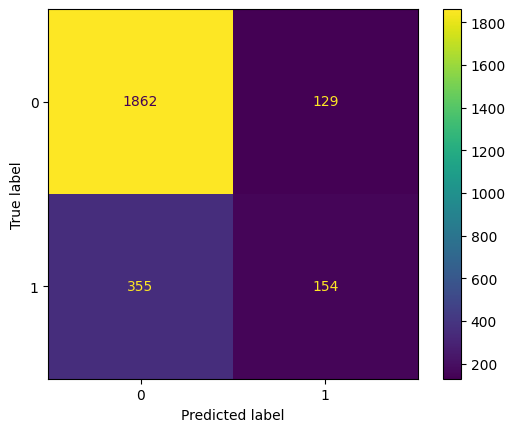

In [42]:
conf_matrix_plot(gnb_scaled, X_test, y_test)

### MOdule 3 K-means for color compression

We will use K-means to cluster the pixel of a photograph of some tulips based on their encoded color values. We will explore how different values of k affect the clustering of the pixels , and thus the appearance of the photograph. We will also examine what is happening "under the hood" as the algorithm executes. 

>

In [44]:
import numpy as np 
import pandas as pd 

%matplotlib inline 
import plotly.graph_objects as go 

from sklearn.cluster import KMeans

In [46]:
# Read in a photo
img = plt.imread('using_kmeans_for_color_compression_tulips_photo.jpg')

(320, 240, 3)


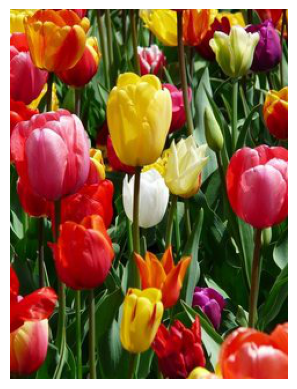

In [48]:
# Display the photo and it dhape 
print(img.shape)
plt.imshow(img)
plt.axis('off');

 TO prepare this data for modeling, we'll reshape it into an array, where each row represents a single pixel's RGB color values. 

In [49]:
# Reshape the image so that each row represents a single pixel 
#Defined by three values: R, G, B
img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
img_flat[:3, :]


array([[211, 196,  41],
       [199, 180,  24],
       [179, 152,   0]], dtype=uint8)

In [50]:
img_flat.shape

(76800, 3)

##### Plot the data in 3D space


In [51]:
# Create a pandas df with r, g, and b as columns
img_flat_df = pd.DataFrame(img_flat, columns = ['r', 'g', 'b'])
img_flat_df.head()

,r,g,b
0,211,196,41
1,199,180,24
2,179,152,0
3,186,150,0
4,187,143,0


In [53]:
# Create 3D plot here each pixel in the img is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g, 
                     z = img_flat_df.b, 
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b in zip(img_flat_df.r.values,
                                img_flat_df.g.values,
                                img_flat_df.b.values)],
                                 opacity=0.5))

data = [trace]
layout = go.Layout(margin=dict(l=0, r=0, b=0, t=0),)

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene = dict(xaxis_title='R',
                              yaxis_title='G',
                              zaxis_title='B'),)
fig.show()

##### Cluster the data: K=1


In [54]:
# Instantiate the model 
kmeans = KMeans(n_clusters=1, random_state=42).fit(img_flat)

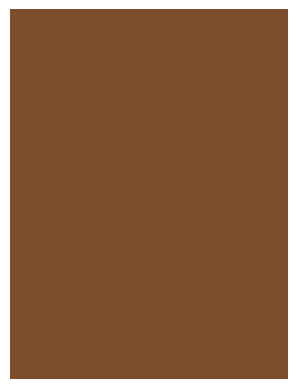

In [55]:
# Copy `img_flat` so we can modify it 
img_flat1 = img_flat.copy()

# Replace each row in the original image with its closest cluster center
for i in np.unique(kmeans.labels_):
    img_flat1[kmeans.labels_==i,:] = kmeans.cluster_centers_[i]
    
# Reshape the data back to (640, 480, 3)
img1 = img_flat1.reshape(img.shape)

plt.imshow(img1)
plt.axis('off');

In [56]:
# Calculate mean of each column in the flattened array 
column_means = img_flat.mean(axis=0)

print('column means: ', column_means)

column means:  [125.64397135  78.93165365  43.51584635]


In [57]:
print('cluster centers: ', kmeans.cluster_centers_)

cluster centers:  [[125.64397135  78.93165365  43.51584635]]


In [58]:
print('cluster centers: ', kmeans.cluster_centers_)


cluster centers:  [[125.64397135  78.93165365  43.51584635]]


In [60]:
# Create 3D plot where each pixel in the `img` is displayed in its actual color
trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=['rgb({},{},{})'.format(r,g,b) for r,g,b in zip(img_flat_df.r.values, img_flat_df.g.values, img_flat_df.b.values)],
                                 opacity=0.5))
data = [trace]

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)

In [61]:
# Add centroid to chart
centroid = kmeans.cluster_centers_[0].tolist()

fig.add_trace(
    go.Scatter3d(x = [centroid[0]],
                 y = [centroid[1]],
                 z = [centroid[2]],
                 mode='markers',
                 marker=dict(size=7,
                             color=['rgb(125.79706706,78.8178776,42.58090169)'],
                             opacity=1))
)
fig.update_layout(scene = dict(
                    xaxis_title='R',
                    yaxis_title='G',
                    zaxis_title='B'),
                  )
fig.show()

##### Cluster the data: k = 3

In [63]:
# Instantiate k-means model for 3 clusters
kmeans3 = KMeans(n_clusters=3, random_state=42).fit(img_flat)

# Check the unique values of what's returened by the .labels_ attribute
np.unique(kmeans3.labels_)

array([0, 1, 2], dtype=int32)

THe `.cluster_centers_` attribute returns an array where each element represents the coordinates of a centroid (Their RGB values). We'll use these coordinates as we did previously to generate the colors that are represented by our centroids.


In [64]:
# Assign centroid coordinates to 'centers' variable
centers = kmeans3.cluster_centers_
centers

array([[202.39763431, 174.37038195, 110.68386223],
       [ 40.83604502,  50.50578017,  16.27870206],
       [177.83256393,  42.71891935,  27.52205853]])

In [67]:
# Helper function that creates color swatches 
def show_swatch(RGB_value):
    """
    Takes in an RGB value and outputs a color swatch."""
    R, G, B = RGB_value 
    rgb = [[np.array([R,G,B]).astype('uint8')]]
    plt.figure()
    plt.imshow(rgb)
    plt.axis('off');

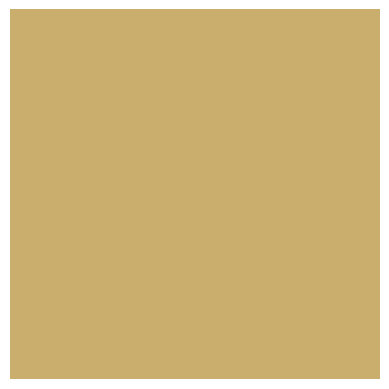

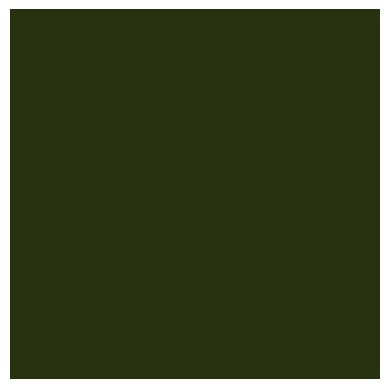

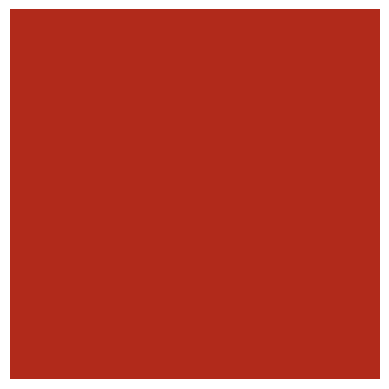

In [68]:
# Display the color swatches
for pixel in centers:
    show_swatch(pixel)

In [69]:
# Helper function to display our photograph when clustered into k clusters
def cluster_image(k, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image.

    Args:
      k:    (int)          - Your selected K-value
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      The output of plt.imshow(new_img), where new_img is a new numpy array \
      where each row of the original array has been replaced with the \ 
      coordinates of its nearest centroid.
    '''

    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters = k, random_state = 42).fit(img_flat)
    new_img = img_flat.copy()
  
    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_ == i, :] = kmeans.cluster_centers_[i]
  
    new_img = new_img.reshape(img.shape)

    return plt.imshow(new_img), plt.axis('off');

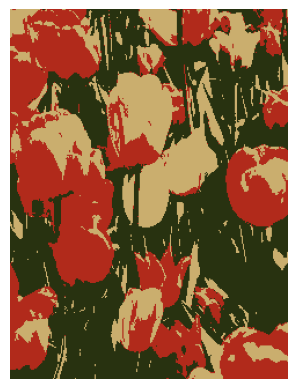

In [70]:
# Genrate image when k=3
cluster_image(3);

In [72]:
# Just to get an understanding of what the data structures look like 

print(kmeans3.labels_.shape)
print(kmeans3.labels_)
print(np.unique(kmeans3.labels_))
print(kmeans3.cluster_centers_)

(76800,)
[0 0 2 ... 2 2 2]
[0 1 2]
[[202.39763431 174.37038195 110.68386223]
 [ 40.83604502  50.50578017  16.27870206]
 [177.83256393  42.71891935  27.52205853]]


In [73]:
# Create a new column in the df that indicates the cluster number of each row 
# (as assigned by Kmeans for k=3)

img_flat_df['cluster']= kmeans3.labels_
img_flat_df.head()

,r,g,b,cluster
0,211,196,41,0
1,199,180,24,0
2,179,152,0,2
3,186,150,0,2
4,187,143,0,2


In [74]:
# Create helper dictionary to map RGB COLOR values to each observation in df 
series_conversion = {0: 'rgb' +str(tuple(kmeans3.cluster_centers_[0])),
                     1: 'rgb' +str(tuple(kmeans3.cluster_centers_[1])),
                     2: 'rgb' +str(tuple(kmeans3.cluster_centers_[2]))}
series_conversion

{0: 'rgb(202.39763430774536, 174.3703819498773, 110.68386222708362)',
 1: 'rgb(40.836045018039115, 50.505780170040836, 16.278702061286065)',
 2: 'rgb(177.83256392758105, 42.71891935289637, 27.522058528360496)'}

In [75]:
# Replace the cluster numbers in the 'cluster' col with formatted RGB values 
# (made ready for plotting)
img_flat_df['cluster'] = img_flat_df['cluster'].map(series_conversion)
img_flat_df.head()

,r,g,b,cluster
0,211,196,41,"rgb(202.39763430774536, 174.3703819498773, 110..."
1,199,180,24,"rgb(202.39763430774536, 174.3703819498773, 110..."
2,179,152,0,"rgb(177.83256392758105, 42.71891935289637, 27...."
3,186,150,0,"rgb(177.83256392758105, 42.71891935289637, 27...."
4,187,143,0,"rgb(177.83256392758105, 42.71891935289637, 27...."


In [77]:
# Replot the data, now showing which cluster (i.e., color) it was assigned to by K-means when k=3

trace = go.Scatter3d(x = img_flat_df.r,
                     y = img_flat_df.g,
                     z = img_flat_df.b,
                     mode='markers',
                     marker=dict(size=1,
                                 color=img_flat_df.cluster,
                                 opacity=1))

data = trace

layout = go.Layout(margin=dict(l=0,
                               r=0,
                               b=0,
                               t=0))

fig = go.Figure(data=data, layout=layout)
fig.show()

##### Cluster the data: k = 2-10 

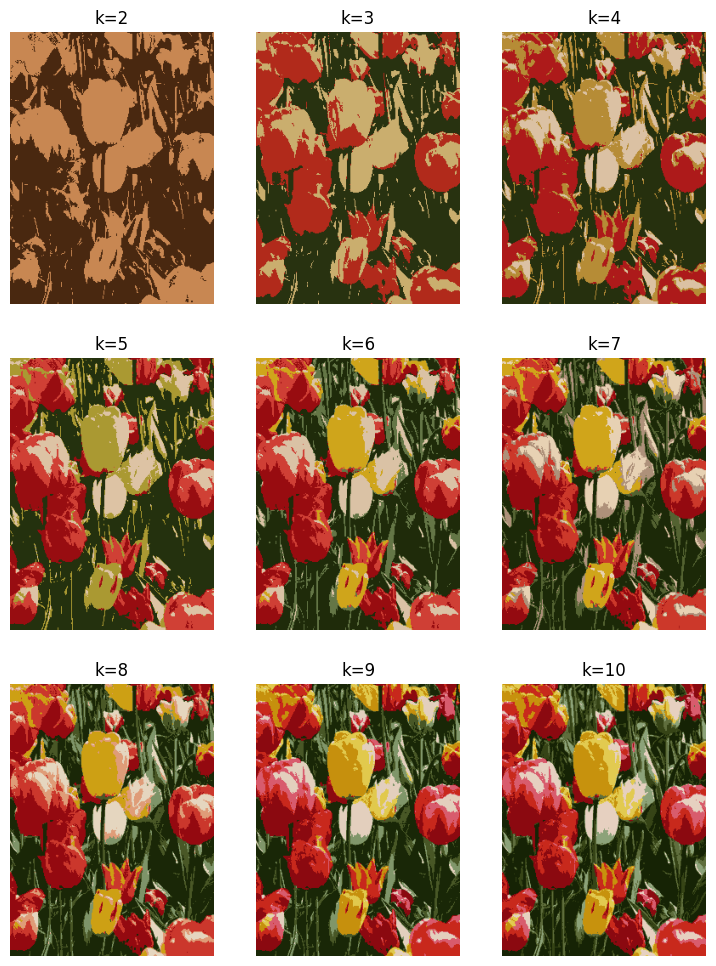

In [78]:
# Helper function to plot image grid 
def cluster_image_grid(k, ax, img=img):
    '''
    Fits a K-means model to a photograph.
    Replaces photo's pixels with RGB values of model's centroids.
    Displays the updated image on an axis of a figure.

    Args:
      k:    (int)          - Your selected K-value
      ax:   (int)          - Index of the axis of the figure to plot to
      img:  (numpy array)  - Your original image converted to a numpy array

    Returns:
      A new image where each row of img's array has been replaced with the \ 
      coordinates of its nearest centroid. Image is assigned to an axis that \
      can be used in an image grid figure.
    '''
    img_flat = img.reshape(img.shape[0]*img.shape[1], 3)
    kmeans = KMeans(n_clusters=k, random_state=42).fit(img_flat)
    new_img = img_flat.copy()

    for i in np.unique(kmeans.labels_):
        new_img[kmeans.labels_==i, :] = kmeans.cluster_centers_[i]

    new_img = new_img.reshape(img.shape)
    ax.imshow(new_img)
    ax.axis('off')

fig, axs = plt.subplots(3, 3)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(9, 12)
axs = axs.flatten()
k_values = np.arange(2, 11)
for i, k in enumerate(k_values):
    cluster_image_grid(k, axs[i], img=img)
    axs[i].title.set_text('k=' + str(k))
    

#### K-means inertia and silhouette score 


In [80]:
# Import statements

# Standard operational package import 
import numpy as np 
import pandas as pd

######################################
# Important imports for modeling and evaluation 
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
######################################

#(To create synthetic data)
from sklearn.datasets import make_blobs

# Visualization package import
import seaborn as sns

In [82]:
# Create random number generator 
rng = np.random.default_rng(seed=44)

In [105]:
# Create synthetic data w/ unknown number of clusters 
centers = rng.integers(low=3, high=7)
X, y, z = make_blobs(n_samples=1000, n_features=6, centers=centers, random_state=42, return_centers=True)

In [106]:
# Create Pandas dataframe from the data 
X = pd.DataFrame(X)
X.head()

,0,1,2,3,4,5
0,6.597330,-5.250127,-6.682249,-7.361722,-4.038499,0.804176
1,-9.754520,6.491701,1.955122,3.445692,-8.906258,10.885443
2,-0.876786,7.584145,4.199834,2.103910,-5.438354,-8.315972
3,-10.205186,7.916090,-0.682091,3.531567,-10.076584,10.031524
4,-1.967735,9.773441,4.063368,-0.617873,-7.425872,-6.488306


###### Scale the data 
`StandardScaler`, `MinMaxScaler`, `Normalizer`


In [85]:
# SCale the data 
X_scaled = StandardScaler().fit_transform(X)
X_scaled[:2,:]


array([[-0.03173691,  0.4864719 , -1.32178135,  0.59808997,  1.5703227 ,
        -0.88951855],
       [-1.05006137,  0.68381835,  0.74465777,  1.2564266 , -0.97057774,
         1.92995522]])

In [86]:
# Instantiate model 
kmeans3 = KMeans(n_clusters=3, random_state=42)

In [87]:
# Fit mode to data
kmeans3.fit(X_scaled)

KMeans(n_clusters=3, random_state=42)

In [88]:
print('Clusters: ', kmeans3.labels_)
print('Inertia: ', kmeans3.inertia_)

Clusters:  [2 0 0 0 1 1 1 0 0 2 1 0 0 2 0 0 0 0 1 1 1 0 0 0 2 2 1 0 0 1 1 0 1 1 2 2 1
 0 0 0 1 0 1 0 0 1 1 2 0 2 1 1 1 2 2 2 1 0 1 2 1 1 1 1 1 1 1 2 1 1 0 1 1 1
 0 1 0 2 2 0 2 0 1 2 1 0 2 2 0 2 0 1 2 0 1 2 1 0 0 1 1 0 0 0 0 0 0 1 1 0 2
 1 0 1 0 0 1 1 2 1 1 1 0 1 1 0 0 1 2 0 2 2 2 1 0 2 2 1 0 1 1 1 0 2 2 2 1 1
 0 1 1 0 1 1 0 0 2 0 2 0 0 1 0 0 0 0 1 1 0 1 0 0 1 0 0 2 0 0 2 2 1 0 1 0 1
 0 2 0 2 0 1 1 1 0 0 0 2 2 0 1 0 0 1 0 1 1 1 1 1 2 1 2 0 0 1 2 2 0 1 1 2 1
 0 0 0 0 1 1 1 0 2 1 2 0 2 0 2 1 1 0 0 0 2 2 1 1 2 2 2 0 0 0 1 1 1 0 0 0 1
 0 1 2 1 0 0 2 2 1 1 0 1 2 0 1 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1 0 2 1 0 1 2 2
 1 0 0 1 0 0 0 0 0 0 2 0 2 1 0 0 2 1 1 0 1 0 0 2 0 1 0 0 0 1 1 1 2 2 2 1 2
 2 2 0 0 2 0 2 1 0 1 2 0 2 1 0 1 0 0 0 0 1 1 0 1 0 1 1 1 2 0 0 0 0 0 1 1 2
 1 0 0 1 0 1 1 0 1 0 2 0 0 1 0 1 1 2 0 1 1 1 2 1 1 0 1 0 1 0 2 0 1 0 0 1 1
 2 0 1 1 2 1 1 0 0 0 0 1 0 1 0 0 2 2 1 2 1 1 1 0 0 2 1 0 0 0 1 0 1 0 2 0 1
 2 1 1 1 0 1 2 0 1 2 0 0 1 1 1 1 1 0 0 1 0 0 1 0 0 1 1 2 1 2 0 1 1 1 1 2 0
 0 1 0 0 2 2 0

The `.labels_` attribute returns a list of values that is the same length as the training data. Each value corresponds to the number of the cluster to which that point is assigned. SInce our K-means model clustered the data into three clusters, the value adssigned to each observation will be 0, 1, or 2

the `.inertia_` attribute returns the sum of the squared distances of samples from their closest cluster center. 


##### Evaluate INertia 


In [89]:
#  Create a list from 2-10
num_clusters = [i for i in range(2, 11)]

def kmeans_inertia(num_clusters, x_vals):
    '''
    Fits a KMeans model for different values of k.
    Calculates an inertia score for each k value.

    Args:
        num_clusters: (list of ints)  - The different k values to try
        x_vals:       (array)         - The training data

    Returns: 
        inertia:      (list)          - A list of inertia scores, one for each \
                                      value of k
    '''
    inertia = []
    for num in num_clusters:
        kmeans = KMeans(n_clusters=num, random_state=42)
        kmeans.fit(x_vals)
        inertia.append(kmeans.inertia_)
    
    return inertia

In [90]:
# Calculate inertia for K=2-10
inertia = kmeans_inertia(num_clusters, X_scaled)
inertia

[3686.2501587328006,
 1748.1488703079513,
 1124.636893573839,
 239.6543475871843,
 232.72871508015132,
 224.29675072289982,
 216.22784318026913,
 210.98989981553572,
 202.3018106935965]

##### Elbow plot 

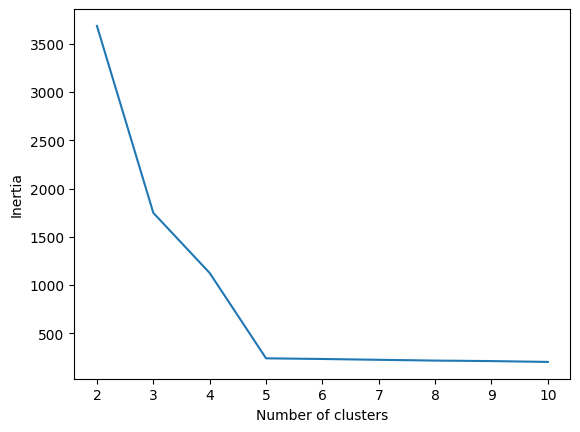

In [91]:
# Create an elbow plot 
plot = sns.lineplot(x=num_clusters, y=inertia)
plot.set_xlabel("Number of clusters");
plot.set_ylabel("Inertia");


##### Evaluate silhouette score

In [92]:
# Get silhouette score for kmeans3 model 
kmeans3_sil_score = silhouette_score(X_scaled, kmeans3.labels_)
kmeans3_sil_score

0.5815196371994132

In [93]:
# Writing a function that compares the silhouette score of each value of k, from 2 through 10. 
def kmeans_sil(num_clusters, x_vals):
    '''
    Fits a KMeans model for different values of k.
    Calculates a silhouette score for each k value.

    Args:
        num_clusters: (list of ints)  - The different k values to try
        x_vals:       (array)         - The training data

    Returns: 
        sil_scores:   (list)          - A list of silhouette scores, one for each \
                                      value of k
    '''
    sil_scores = []
    for num in num_clusters:
        kmeans = KMeans(n_clusters=num, random_state=42)
        kmeans.fit(x_vals)
        sil_scores.append(silhouette_score(x_vals, kmeans.labels_))
    
    return sil_scores

In [95]:
# Calculate silhouette scores for k=2-10
sil_score = kmeans_sil(num_clusters, X_scaled)
sil_score

[0.42005966017510427,
 0.5815196371994132,
 0.649060841277744,
 0.7670656870960783,
 0.6376325996351013,
 0.5100290191946069,
 0.4024771015104519,
 0.3998551090636554,
 0.2748795855657769]

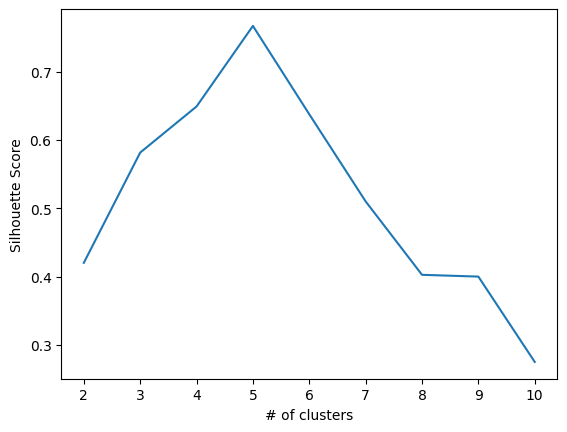

In [96]:
# Create a line plot of silhouette scores 
plot = sns.lineplot(x=num_clusters, y=sil_score)
plot.set_xlabel("# of clusters");
plot.set_ylabel("Silhouette Score");

In [97]:
# Verify our findings (only possible when "correct" number of clusters exists)
centers

5

##### Further analysis 


In [98]:
# Fit a 5 cluster model to the data 
kmeans5 = KMeans(n_clusters=5, random_state=42)
kmeans5.fit(X_scaled)

KMeans(n_clusters=5, random_state=42)

In [99]:
print(kmeans5.labels_[:5])
print('Unique labels:', np.unique(kmeans5.labels_))

[2 4 4 4 1]
Unique labels: [0 1 2 3 4]


In [100]:
# Create new column that indicates cluster assignment in original dataframe 
X['cluster'] = kmeans5.labels_
X.head()

,0,1,2,3,4,5,cluster
0,-1.534288,5.467808,-6.945988,1.403934,1.553836,-7.618236,2
1,-6.681020,6.717808,2.764396,4.460744,-8.286569,10.959708,4
2,-8.678310,7.825306,3.139699,5.609951,-9.948079,8.072149,4
3,-6.667385,7.147637,2.145505,4.712937,-9.544708,11.093248,4
4,-2.753835,-4.209968,0.620345,-7.439505,-4.405723,-2.046149,1


##### Predicting on new data 

In [101]:
# Create a new observation (for demonstration)
new_observation = rng.uniform(low=-10, high=10, size=6).reshape(1, -1)
new_observation

array([[-4.8377385 , -1.88458544,  9.38367896, -6.7536575 ,  7.14587347,
        -6.73909458]])

In [102]:
# Instantiate the scaler and fit it to the original X data
scaler = StandardScaler().fit(X.iloc[:,:-1])

# Apply the scaler to the new observation
new_observation_scaled = scaler.transform(new_observation)
new_observation_scaled

array([[-0.68535259, -0.67430308,  2.1532887 , -1.15878741,  3.01424824,
        -0.75609599]])

In [103]:
# Predict cluster assignment of new_observation
new_prediction = kmeans5.predict(new_observation_scaled)
new_prediction

array([1], dtype=int32)

In [104]:
# Calculate distances between new data and each centroid
distances = kmeans5.transform(new_observation_scaled)
distances

array([[4.55233304, 3.46792667, 4.14567617, 5.11675395, 5.95732403]])

### Module 4 Decision tree
#### Modeling objective 
is to build and test a decision tree model that uses banking data to predict whether a customer will churn. If a customer churns, it means they left the bank and took their business elsewhere. If we can predict customers who are likely to churn, we can take measures to retain them before they do. 

#### Build a decision tree with Python 

In [107]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

# This function display the split of the tree
from sklearn.tree import plot_tree

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from sklearn.metrics import recall_score, precision_score, f1_score, accuracy_score

In [108]:
# Read in the data 

file = 'Churn_Modelling.csv'
df_original = pd.read_csv(file)
df_original.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


##### Examine the data


In [109]:
# Check class balance 
df_original['Exited'].value_counts()

Exited
0    7963
1    2037
Name: count, dtype: int64

##### Select an evaluation metric


In [110]:
# Calculate average balance of customers who churned 
avg_churned_bal = df_original[df_original['Exited']==1]['Balance'].mean()
avg_churned_bal

91108.53933726068

In [111]:
# Create a new df that drops RowNumber, CustomerId, Surname, and Gender cols
churn_df = df_original.drop(['RowNumber', 'CustomerId', 'Surname', 'Gender'], axis=1)

In [112]:
churn_df.head()

,CreditScore,Geography,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,619,France,42,2,0.00,1,1,1,101348.88,1
1,608,Spain,41,1,83807.86,1,0,1,112542.58,0
2,502,France,42,8,159660.80,3,1,0,113931.57,1
3,699,France,39,1,0.00,2,0,0,93826.63,0
4,850,Spain,43,2,125510.82,1,1,1,79084.10,0


In [113]:
# Dummy encode categorica; variable 
churn_df = pd.get_dummies(churn_df, drop_first=True)
churn_df.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Geography_Germany,Geography_Spain
0,619,42,2,0.00,1,1,1,101348.88,1,False,False
1,608,41,1,83807.86,1,0,1,112542.58,0,False,True
2,502,42,8,159660.80,3,1,0,113931.57,1,False,False
3,699,39,1,0.00,2,0,0,93826.63,0,False,False
4,850,43,2,125510.82,1,1,1,79084.10,0,False,True


In [119]:
# Define the y(target variable 
y = churn_df['Exited']

# Define the X (predictor) variables
X = churn_df.copy()
X = X.drop('Exited', axis=1)

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=y, random_state=42)

##### Baseline Model 
We'll first train a baseline model, just to get a sense of how predictive the data is and to give us scores that we can reference later. This will also show the process of instantiating and fitting the model, and then using it to make predictions. We'll predict on the test data

In [120]:
# Instantiate the model 
decision_tree = DecisionTreeClassifier(random_state=0)
# fit the model to training data 
decision_tree.fit(X_train, y_train)

# Make predictions on test data 
dt_pred = decision_tree.predict(X_test)

In [121]:
# Generate performance metrics
print("Accuracy:", "%.3f" % accuracy_score(y_test, dt_pred))
print("Precision:", "%.3f" % precision_score(y_test, dt_pred))
print("Recall:", "%.3f" % recall_score(y_test, dt_pred))
print("F1 Score:", "%.3f" % f1_score(y_test, dt_pred))

Accuracy: 0.790
Precision: 0.486
Recall: 0.503
F1 Score: 0.494


##### Analysis of baseline model 
Confusion Matrix:


In [124]:
def conf_matrix_plot(model, x_data, y_data):
    '''
    Accepts as argument model object, X data (test or validate), and y data (test or validate).
    Returns a plot of confusion matrix for predictions on y data.'''
    
    model_pred = model.predict(x_data)
    cm = confusion_matrix(y_data, model_pred, labels=model.classes_)  
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(values_format='') # `values_format=''` suppresses scientific notation
    plt.show()

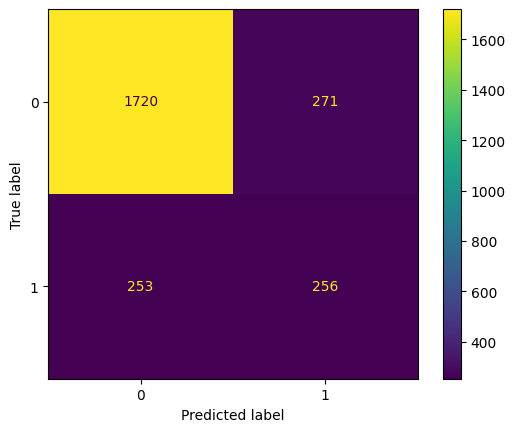

In [125]:
# Generate confusion matrix
conf_matrix_plot(decision_tree, X_test, y_test)

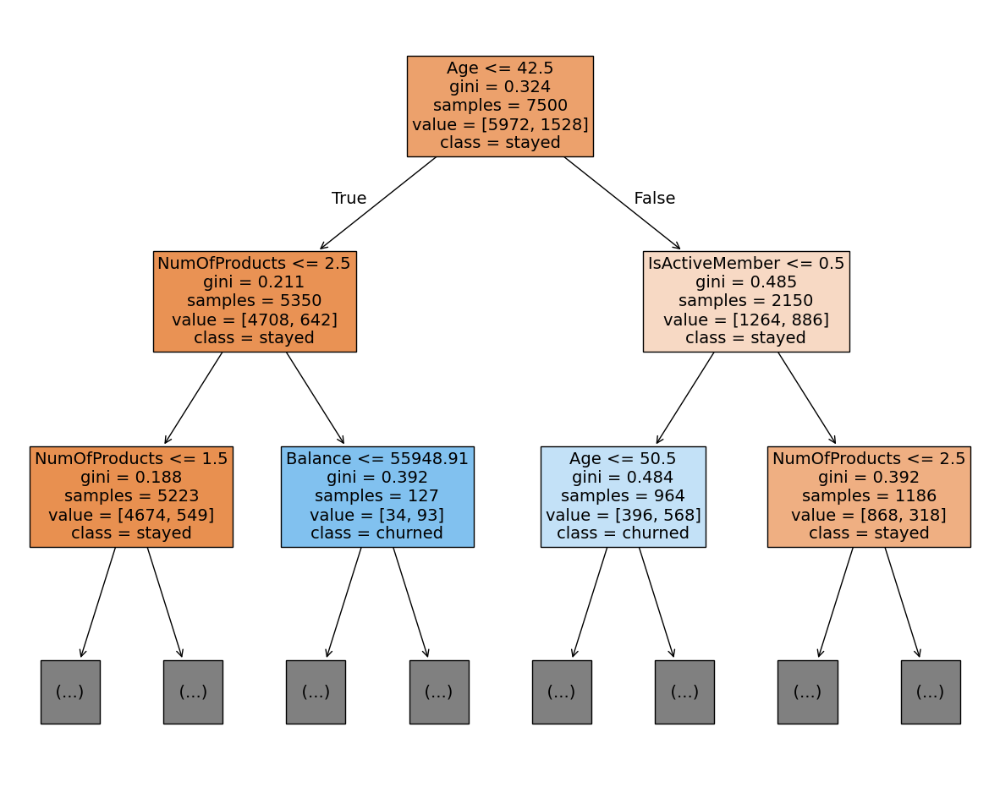

In [126]:
# PLot the tree
plt.figure(figsize=(15,12))
plot_tree(decision_tree, max_depth=2, fontsize=14, feature_names=X.columns, class_names={0:'stayed', 1:'churned'}, filled=True);
plt.show()

##### Tune and validate decision trees with Python 
This pa

In [127]:
# IMport GridSearchCV
from sklearn.model_selection import GridSearchCV


In [128]:
# Assign a dictionary of hyperparameters to search over
tree_para = {'max_depth':[4,5,6,7,8,9,10,11,12,15,20,30,40,50],
             'min_samples_leaf':[2, 5, 10, 20, 50]}

> Create a dictionary of scoring metrics to capture. These metrics can be selected from scikit-learn's built in options or custom-defined. 

In [135]:
# Assign a dictionary of scoring metrics to capture
scoring = {'accuracy': 'accuracy', 'precision': 'precision', 'recall': 'recall', 'f1': 'f1'}


In [136]:
# Instantiate the classifier
tuned_decision_tree = DecisionTreeClassifier(random_state = 42)

In [137]:
# Instatiate the GridSearch 
clf = GridSearchCV(tuned_decision_tree, tree_para, scoring=scoring, cv=5, refit="f1")

# Fit the model 
clf.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 20, 30,
                                       40, 50],
                         'min_samples_leaf': [2, 5, 10, 20, 50]},
             refit='f1',
             scoring={'accuracy': 'accuracy', 'f1': 'f1',
                      'precision': 'precision', 'recall': 'recall'})

In [138]:
# Examine the best model from GridSearch
clf.best_estimator_

DecisionTreeClassifier(max_depth=8, min_samples_leaf=20, random_state=42)

In [139]:
print("Best Avg. Validation Score: ", "%.4f" % clf.best_score_)

Best Avg. Validation Score:  0.5607


In [140]:
def make_results(model_name, model_object):
    '''
    Accepts as arguments a model name (your choice - string) and
    a fit GridSearchCV model object.
  
    Returns a pandas df with the F1, recall, precision, and accuracy scores
    for the model with the best mean F1 score across all validation folds.  
    '''

    # Get all the results from the CV and put them in a df
    cv_results = pd.DataFrame(model_object.cv_results_)

    # Isolate the row of the df with the max(mean f1 score)
    best_estimator_results = cv_results.iloc[cv_results['mean_test_f1'].idxmax(), :]

    # Extract accuracy, precision, recall, and f1 score from that row
    f1 = best_estimator_results.mean_test_f1
    recall = best_estimator_results.mean_test_recall
    precision = best_estimator_results.mean_test_precision
    accuracy = best_estimator_results.mean_test_accuracy
  
    # Create table of results
    table = pd.DataFrame({'Model': [model_name],
                        'F1': [f1],
                        'Recall': [recall],
                        'Precision': [precision],
                        'Accuracy': [accuracy]
                         }
                        )
  
    return table

In [143]:
# Call the function on our model 
result_table = make_results("Tuned Decision Tree", clf)

In [144]:
# Save results table as csv 
result_table.to_csv("Results.csv")

In [145]:
result_table

,Model,F1,Recall,Precision,Accuracy
0,Tuned Decision Tree,0.560655,0.469255,0.701608,0.8504


#### Bootstrap aggregation
